In [3]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session


/kaggle/input/classical-music-midi/brahms/br_im2.mid
/kaggle/input/classical-music-midi/brahms/br_im5.mid
/kaggle/input/classical-music-midi/brahms/BR_IM6.MID
/kaggle/input/classical-music-midi/brahms/brahms_opus1_4.mid
/kaggle/input/classical-music-midi/brahms/brahms_opus117_2.mid
/kaggle/input/classical-music-midi/brahms/brahms_opus1_2.mid
/kaggle/input/classical-music-midi/brahms/brahms_opus1_1.mid
/kaggle/input/classical-music-midi/brahms/brahms_opus1_3.mid
/kaggle/input/classical-music-midi/brahms/br_rhap.mid
/kaggle/input/classical-music-midi/brahms/brahms_opus117_1.mid
/kaggle/input/classical-music-midi/granados/gra_esp_4.mid
/kaggle/input/classical-music-midi/granados/gra_esp_2.mid
/kaggle/input/classical-music-midi/granados/gra_esp_3.mid
/kaggle/input/classical-music-midi/debussy/debussy_cc_2.mid
/kaggle/input/classical-music-midi/debussy/debussy_cc_1.mid
/kaggle/input/classical-music-midi/debussy/DEB_CLAI.MID
/kaggle/input/classical-music-midi/debussy/debussy_cc_3.mid
/kaggle

In [10]:
!pip install music21

In [11]:
!apt-get install -y lilypond

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  dvisvgm fonts-lmodern libkpathsea6 libptexenc1 libsynctex2 libteckit0
  libtexlua53 libtexluajit2 libwoff1 libzzip-0-13 lilypond-data lilypond-fonts
  lmodern t1utils tex-common texlive-base texlive-binaries texlive-latex-base
  xfonts-encodings xfonts-utils
Suggested packages:
  lilypond-doc python3-lxml debhelper perl-tk xpdf | pdf-viewer xzdec
  texlive-latex-base-doc
The following NEW packages will be installed:
  dvisvgm fonts-lmodern libkpathsea6 libptexenc1 libsynctex2 libteckit0
  libtexlua53 libtexluajit2 libwoff1 libzzip-0-13 lilypond lilypond-data
  lilypond-fonts lmodern t1utils tex-common texlive-base texlive-binaries
  texlive-latex-base xfonts-encodings xfonts-utils
0 upgraded, 21 newly installed, 0 to remove and 132 not upgraded.
Need to get 54.2 MB of archives.
After this operation, 179 MB of additional disk space will 

In [12]:
import tensorflow 
import numpy as np 
import pandas as pd 
from collections import Counter
import random
import IPython
from IPython.display import Image, Audio
import music21
from music21 import *
import matplotlib.pyplot as plt 
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import Adamax
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
%matplotlib inline
import sys
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter("ignore")
np.random.seed(42)

In [6]:
filepath = "../input/classical-music-midi/chopin/"
#Getting midi files
all_midis= []
for i in os.listdir(filepath):
    if i.endswith(".mid"):
        tr = filepath+i
        midi = converter.parse(tr)
        all_midis.append(midi)

In [13]:
def extract_notes(file):
    notes = []
    pick = None
    for j in file:
        songs = instrument.partitionByInstrument(j)
        for part in songs.parts:
            pick = part.recurse()
            for element in pick:
                if isinstance(element, note.Note):
                    notes.append(str(element.pitch))
                elif isinstance(element, chord.Chord):
                    notes.append(".".join(str(n) for n in element.normalOrder))

    return notes
#Getting the list of notes as Corpus
Corpus= extract_notes(all_midis)
print("Total notes in all the Chopin midis in the dataset:", len(Corpus))

Total notes in all the Chopin midis in the dataset: 57894


In [14]:
print("First fifty values in the Corpus:", Corpus[:50])

First fifty values in the Corpus: ['6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', '6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', '6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', 'F4', 'B4', 'C#2', 'G3', 'B-3', 'G#3', 'G#4', 'B3', 'C#3', '6.10.1', 'F#2', 'F3', 'G#3', 'F#3', 'B-3', 'C#3', 'C#4', '6.10', 'F#2', 'F3', 'G#3', 'F#3', '6.10', 'B-3', 'C#3', 'C#4', '6.10', 'F#2', 'F3']


Changing working directory to: `/tmp/music21'
Processing `/tmp/music21/tmp5eaynhz9.ly'
Parsing...
Interpreting music...[8][16][24][32][32]
Preprocessing graphical objects...
Calculating line breaks... 
Drawing systems... 
Layout output to `tmp5eaynhz9.ly.eps'...
Converting to PNG...
Layout output to `tmp5eaynhz9.ly-1.eps'...
Layout output to `tmp5eaynhz9.ly-2.eps'...
Layout output to `tmp5eaynhz9.ly-3.eps'...
Layout output to `tmp5eaynhz9.ly-4.eps'...
Layout output to `tmp5eaynhz9.ly-5.eps'...
Writing tmp5eaynhz9.ly-systems.texi...
Writing tmp5eaynhz9.ly-systems.tex...
Writing tmp5eaynhz9.ly-systems.count...
Success: compilation successfully completed


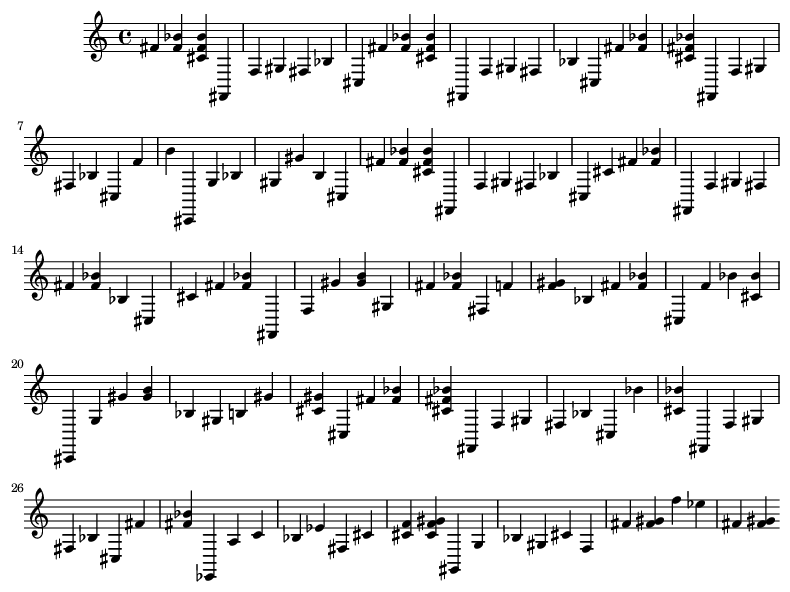

In [15]:
def show(music):
    display(Image(str(music.write("lily.png"))))
    
def chords_n_notes(Snippet):
    Melody = []
    offset = 0 #Incremental
    for i in Snippet:
        #If it is chord
        if ("." in i or i.isdigit()):
            chord_notes = i.split(".") #Seperating the notes in chord
            notes = [] 
            for j in chord_notes:
                inst_note=int(j)
                note_snip = note.Note(inst_note)            
                notes.append(note_snip)
                chord_snip = chord.Chord(notes)
                chord_snip.offset = offset
                Melody.append(chord_snip)
        # pattern is a note
        else: 
            note_snip = note.Note(i)
            note_snip.offset = offset
            Melody.append(note_snip)
        # increase offset each iteration so that notes do not stack
        offset += 1
    Melody_midi = stream.Stream(Melody)   
    return Melody_midi

Melody_Snippet = chords_n_notes(Corpus[:100])
show(Melody_Snippet)

In [16]:
Melody_Snippet.write('midi', fp='melody_snippet.mid')

'melody_snippet.mid'

In [17]:
!apt-get install -y timidity > /dev/null 2>&1
!timidity melody_snippet.mid -Ow -o melody_snippet.wav

from IPython.display import Audio, display
display(Audio('melody_snippet.wav'))

Playing melody_snippet.mid
MIDI file: melody_snippet.mid
Format: 1  Tracks: 2  Divisions: 10080
Track name: 
Playing time: ~54 seconds
Notes cut: 0
Notes lost totally: 0


In [18]:
count_num = Counter(Corpus)
print("Total unique notes in the Corpus:", len(count_num))

Total unique notes in the Corpus: 397


In [19]:
Notes = list(count_num.keys())
Recurrence = list(count_num.values())
#Average recurrenc for a note in Corpus
def Average(lst):
    return sum(lst) / len(lst)
print("Average recurrenc for a note in Corpus:", Average(Recurrence))
print("Most frequent note in Corpus appeared:", max(Recurrence), "times")
print("Least frequent note in Corpus appeared:", min(Recurrence), "time")

Average recurrenc for a note in Corpus: 145.8287153652393
Most frequent note in Corpus appeared: 1627 times
Least frequent note in Corpus appeared: 1 time


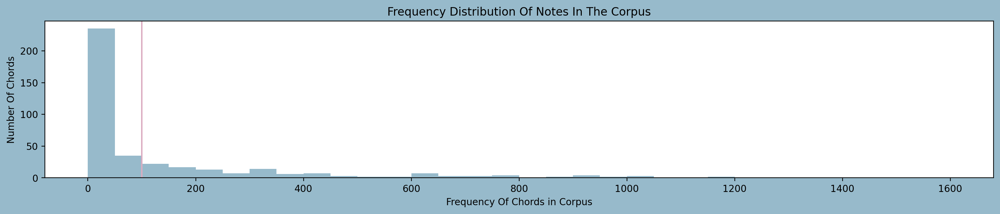

In [20]:
plt.figure(figsize=(18,3),facecolor="#97BACB")
bins = np.arange(0,(max(Recurrence)), 50) 
plt.hist(Recurrence, bins=bins, color="#97BACB")
plt.axvline(x=100,color="#DBACC1")
plt.title("Frequency Distribution Of Notes In The Corpus")
plt.xlabel("Frequency Of Chords in Corpus")
plt.ylabel("Number Of Chords")
plt.show()

In [21]:
rare_note = []
for index, (key, value) in enumerate(count_num.items()):
    if value < 100:
        m =  key
        rare_note.append(m)
        
print("Total number of notes that occur less than 100 times:", len(rare_note))

Total number of notes that occur less than 100 times: 270


In [22]:
for element in Corpus:
    if element in rare_note:
        Corpus.remove(element)

print("Length of Corpus after elemination the rare notes:", len(Corpus))

Length of Corpus after elemination the rare notes: 53745


In [23]:
symb = sorted(list(set(Corpus)))

L_corpus = len(Corpus) #length of corpus
L_symb = len(symb) #length of total unique characters

#Building dictionary to access the vocabulary from indices and vice versa
mapping = dict((c, i) for i, c in enumerate(symb))
reverse_mapping = dict((i, c) for i, c in enumerate(symb))

print("Total number of characters:", L_corpus)
print("Number of unique characters:", L_symb)

Total number of characters: 53745
Number of unique characters: 255


In [24]:
length = 40
features = []
targets = []
for i in range(0, L_corpus - length, 1):
    feature = Corpus[i:i + length]
    target = Corpus[i + length]
    features.append([mapping[j] for j in feature])
    targets.append(mapping[target])
    
    
L_datapoints = len(targets)
print("Total number of sequences in the Corpus:", L_datapoints)

Total number of sequences in the Corpus: 53705


In [25]:
# reshape X and normalize
X = (np.reshape(features, (L_datapoints, length, 1)))/ float(L_symb)
# one hot encode the output variable
y = tensorflow.keras.utils.to_categorical(targets) 

In [26]:
X_train, X_seed, y_train, y_seed = train_test_split(X, y, test_size=0.2, random_state=42)

In [30]:
import tensorflow as tf
print("Num GPUs Available: ", 
len(tf.config.experimental.list_physical_devices('GPU')))

Num GPUs Available:  2


In [31]:
model = Sequential()
#Adding layers
model.add(LSTM(512, input_shape=(X.shape[1], X.shape[2]), return_sequences=True))
model.add(Dropout(0.1))
model.add(LSTM(256))
model.add(Dense(256))
model.add(Dropout(0.1))
model.add(Dense(y.shape[1], activation='softmax'))
#Compiling the model for training  
opt = Adamax(learning_rate=0.01)
model.compile(loss='categorical_crossentropy', optimizer=opt)

I0000 00:00:1760451161.641164      37 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13942 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5
I0000 00:00:1760451161.641928      37 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 13942 MB memory:  -> device: 1, name: Tesla T4, pci bus id: 0000:00:05.0, compute capability: 7.5


In [32]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 40, 512)        │     1,052,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 40, 512)        │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm_1 (LSTM)                   │ (None, 256)            │       787,456 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │        65,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 255)            │        65,535 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 1,971,455 (7.52 MB)

 Trainable params: 1,971,455 (7.52 MB)

 Non-trainable params: 0 (0.00 B)

In [33]:
history = model.fit(X_train, y_train, batch_size=256, epochs=200)

Epoch 1/200


I0000 00:00:1760451181.413881    1155 cuda_dnn.cc:529] Loaded cuDNN version 90300


168/168 ━━━━━━━━━━━━━━━━━━━━ 12s 41ms/step - loss: 4.8786
Epoch 2/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 41ms/step - loss: 4.6786
Epoch 3/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 40ms/step - loss: 4.5227
Epoch 4/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 41ms/step - loss: 4.4534
Epoch 5/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 41ms/step - loss: 4.4443
Epoch 6/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 41ms/step - loss: 4.4281
Epoch 7/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 41ms/step - loss: 4.4111
Epoch 8/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 42ms/step - loss: 4.4069
Epoch 9/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 42ms/step - loss: 4.3912
Epoch 10/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 43ms/step - loss: 4.3643
Epoch 11/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 43ms/step - loss: 4.3289
Epoch 12/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - loss: 4.2691
Epoch 13/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - loss: 4.2340
Epoch 14/200
168/168 ━━━━━━━━━━━━━━━━━━━━ 7s 44ms/step - loss: 4.1550
Epoch 15/200
168/168 ━━━━━━━━━━━━━━━━━━━

[Text(0.5, 0, 'Epochs')]

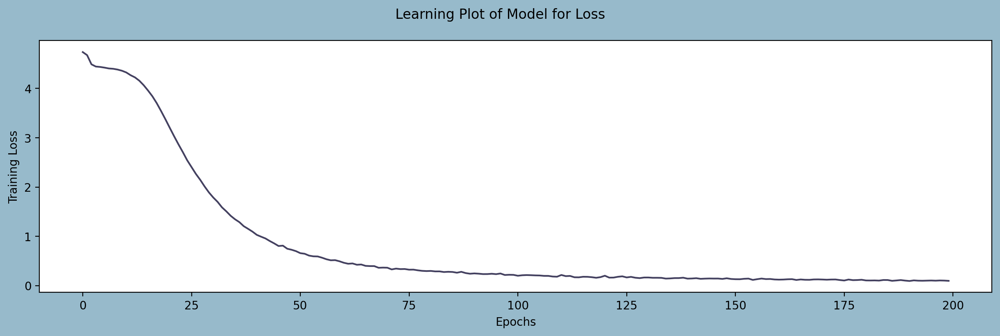

In [34]:
#Plotting the learnings 
history_df = pd.DataFrame(history.history)
fig = plt.figure(figsize=(15,4), facecolor="#97BACB")
fig.suptitle("Learning Plot of Model for Loss")
pl=sns.lineplot(data=history_df["loss"],color="#444160")
pl.set(ylabel ="Training Loss")
pl.set(xlabel ="Epochs")

Changing working directory to: `/tmp/music21'
Processing `/tmp/music21/tmpf38sjhi3.ly'
Parsing...
Interpreting music...[8][16][24]
Preprocessing graphical objects...
Calculating line breaks... 
Drawing systems... 
Layout output to `tmpf38sjhi3.ly.eps'...
Converting to PNG...
Layout output to `tmpf38sjhi3.ly-1.eps'...
Layout output to `tmpf38sjhi3.ly-2.eps'...
Layout output to `tmpf38sjhi3.ly-3.eps'...
Writing tmpf38sjhi3.ly-systems.texi...
Writing tmpf38sjhi3.ly-systems.tex...
Writing tmpf38sjhi3.ly-systems.count...
Success: compilation successfully completed


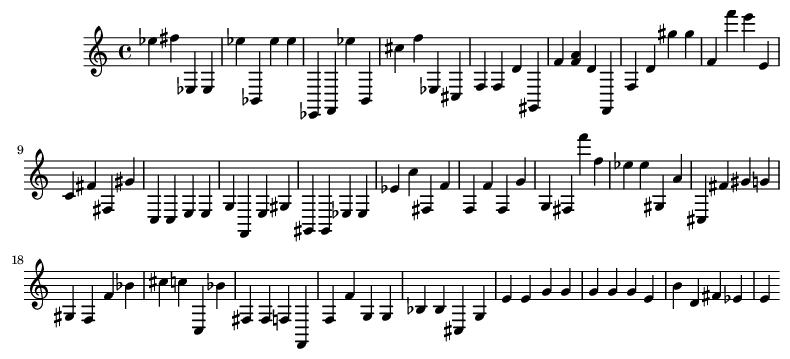

In [35]:
def Malody_Generator(Note_Count):
    seed = X_seed[np.random.randint(0,len(X_seed)-1)]
    Music = ""
    Notes_Generated=[]
    for i in range(Note_Count):
        seed = seed.reshape(1,length,1)
        prediction = model.predict(seed, verbose=0)[0]
        prediction = np.log(prediction) / 1.0 #diversity
        exp_preds = np.exp(prediction)
        prediction = exp_preds / np.sum(exp_preds)
        index = np.argmax(prediction)
        index_N = index/ float(L_symb)   
        Notes_Generated.append(index)
        Music = [reverse_mapping[char] for char in Notes_Generated]
        seed = np.insert(seed[0],len(seed[0]),index_N)
        seed = seed[1:]
    #Now, we have music in form or a list of chords and notes and we want to be a midi file.
    Melody = chords_n_notes(Music)
    Melody_midi = stream.Stream(Melody)   
    return Music,Melody_midi


#getting the Notes and Melody created by the model
Music_notes, Melody = Malody_Generator(100)
show(Melody)

In [38]:
Melody.write('midi', 'Melody_Generated.mid')


'Melody_Generated.mid'

In [40]:
!apt-get install -y timidity > /dev/null 2>&1
!timidity Melody_Generated.mid -Ow -o Melody_Generated.wav

# 3. Play the generated WAV file
display(Audio("Melody_Generated.wav"))

Playing Melody_Generated.mid
MIDI file: Melody_Generated.mid
Format: 1  Tracks: 2  Divisions: 10080
Track name: 
Playing time: ~54 seconds
Notes cut: 0
Notes lost totally: 0
